In [1]:
import numpy as np
import torch
from torch.nn import functional as F
from torch import nn
from pytorch_lightning.core.lightning import LightningModule

from torch.utils.data import DataLoader, random_split
from torchvision.datasets import FashionMNIST
import os
from torchvision import datasets, transforms
from torch.optim import Adam

from pytorch_lightning import Trainer, seed_everything

import utils as utils

DATA_DIR = './fashionMNIST/'

In [2]:
class LitMNIST(LightningModule):

    def __init__(self):
        super().__init__()

        # mnist images are (1, 28, 28) (channels, width, height)
        self.layer_1 = torch.nn.Linear(28 * 28, 128)
        self.layer_2 = torch.nn.Linear(128, 32)
        self.layer_3 = torch.nn.Linear(32, 128)
        self.layer_4 = torch.nn.Linear(128, 28 * 28)
        

    def forward(self, x):
        batch_size, channels, width, height = x.size()
        
        x = x.view(batch_size, -1)
        x = self.layer_1(x)
        x = torch.relu(x)
        
        x = self.layer_2(x)
        x = torch.relu(x)
        
        x = self.layer_3(x)
        x = torch.relu(x)
        
        x = self.layer_4(x)

        return x
    
    def embedding_vector(self, x):
        
        batch_size, channels, width, height = x.size()
        
        x = x.view(batch_size, -1)
        x = self.layer_1(x)
        x = torch.relu(x)
        
        x = self.layer_2(x)
        x = torch.relu(x)
        
        return x
        
    def mse_loss(self, logits, labels):
        return F.mse_loss(logits, labels)

    def prepare_data(self):
        # transforms for images
        transform=transforms.Compose([transforms.ToTensor()])
        fmnist_train = FashionMNIST(DATA_DIR, train=True, download=True, transform=transform)
        self.fmnist_test = FashionMNIST(DATA_DIR, train=False, download=True, transform=transform)
        
        self.fmnist_train, self.fmnist_val = random_split(fmnist_train, [55000, 5000])
        
    def train_dataloader(self):
        return DataLoader(self.fmnist_train, batch_size=64, num_workers=utils.get_num_cpus())

    def val_dataloader(self):
        return DataLoader(self.fmnist_val, batch_size=64, num_workers=utils.get_num_cpus())

    def test_dataloader(self):
        return DataLoader(self.fmnist_test, batch_size=64, num_workers=utils.get_num_cpus())

    def configure_optimizers(self):
        return Adam(self.parameters(), lr=1e-3)

    def training_step(self, batch, batch_idx):
        x, y = batch
        
        logits = self.forward(x)
        x = torch.flatten(x, start_dim=1)
        loss = self.mse_loss(logits, x)
        
        logs = {'train_loss': loss}
        return {'loss': loss, 'log': logs}
    
    def validation_step(self, batch, batch_idx):
        x, y = batch
        logits = self(x)
        x = torch.flatten(x, start_dim=1)
        loss = self.mse_loss(logits, x)
        return {'val_loss': loss}
    
    def validation_epoch_end(self, outputs):
        avg_loss = torch.stack([x['val_loss'] for x in outputs]).mean()
        tensorboard_logs = {'val_loss': avg_loss}
        return {'val_loss': avg_loss, 'log': tensorboard_logs}
    
    def test_step(self, batch, batch_idx):
        x, y = batch
        #batch_size, channels, width, height = x.size()
        logits = self(x)
        x = torch.flatten(x, start_dim=1)
        loss = self.mse_loss(logits, x)
        
        return {'test_loss': loss}

    def test_epoch_end(self, outputs):
        avg_loss = torch.stack([x['test_loss'] for x in outputs]).mean()
        tensorboard_logs = {'test_loss': avg_loss}
        return {'test_loss': avg_loss, 'log': tensorboard_logs}

In [3]:
net = LitMNIST()
x = torch.Tensor(1, 1, 28, 28)
out = net(x)

In [4]:
net.prepare_data()

In [5]:
# Class map from the fashion mnist website https://github.com/zalandoresearch/fashion-mnist
classes = {0: 'T-shirt/top',
           1: 'Trouser',
           2: 'Pullover',
           3: 'Dress',
           4: 'Coat',
           5: 'Sandal',
           6: 'Shirt',
           7: 'Sneaker',
           8: 'Bag',
           9: 'Ankle Boot'}

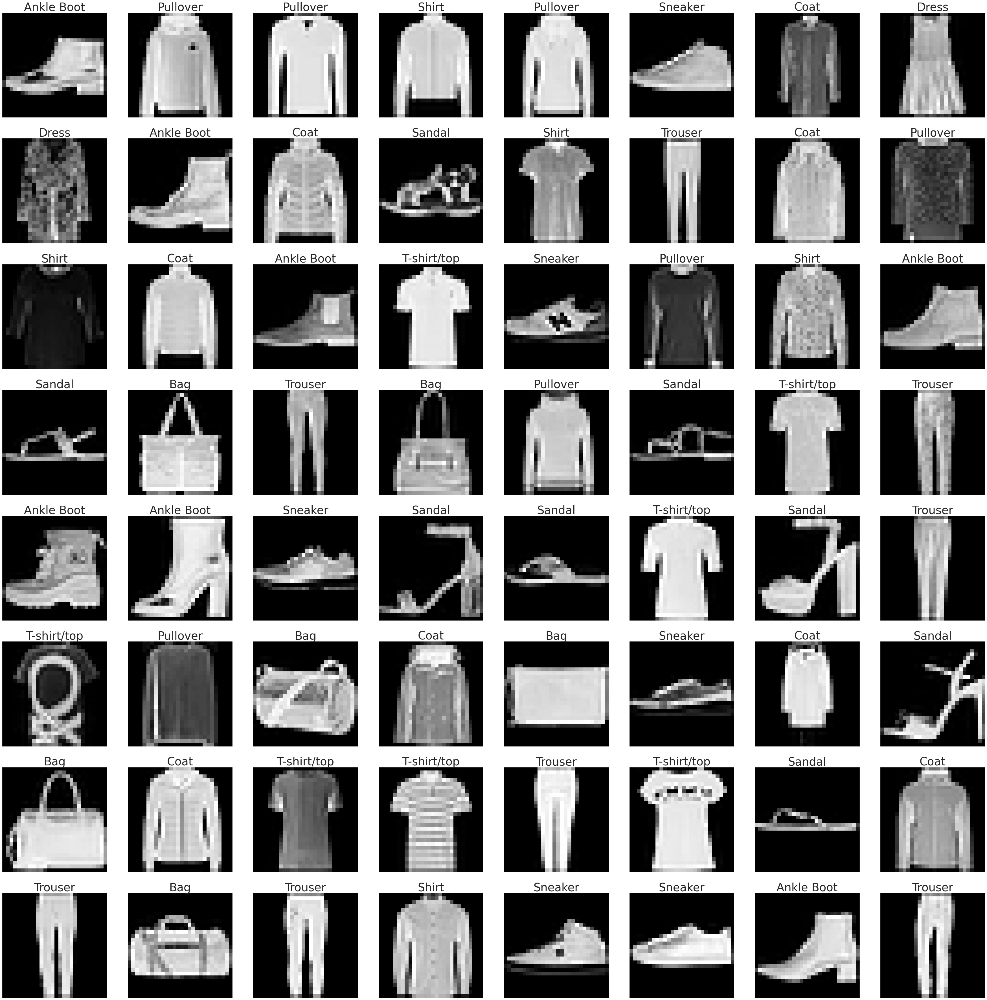

In [6]:
dl = net.train_dataloader()
utils.display_grid_data(dl, classes, ncols=8)

In [7]:
# Setup lightning for reproducability between runs.  That way we can
# make tweaks and see what the effect on performance is.  If we don't set this we will
# get different accuracy results between runs, and will complicate measuring the effect
# of our changes on the performance.  We also have to setup the trainer for deterministic
# runs as well (below)

seed_val = 42
seed_everything(seed_val)

42

In [8]:
model = LitMNIST()
# Set the trainer for deterministic runs.
trainer = Trainer(max_epochs=5, deterministic=True)
trainer.fit(model)

GPU available: False, used: False
TPU available: False, using: 0 TPU cores

  | Name    | Type   | Params
-----------------------------------
0 | layer_1 | Linear | 100 K 
1 | layer_2 | Linear | 4 K   
2 | layer_3 | Linear | 4 K   
3 | layer_4 | Linear | 101 K 


1

In [9]:
trainer.test()

--------------------------------------------------------------------------------
TEST RESULTS
{'test_loss': tensor(0.0152)}
--------------------------------------------------------------------------------



{'test_loss': 0.01515522412955761}

In [10]:
%load_ext autoreload

In [11]:
%autoreload 2

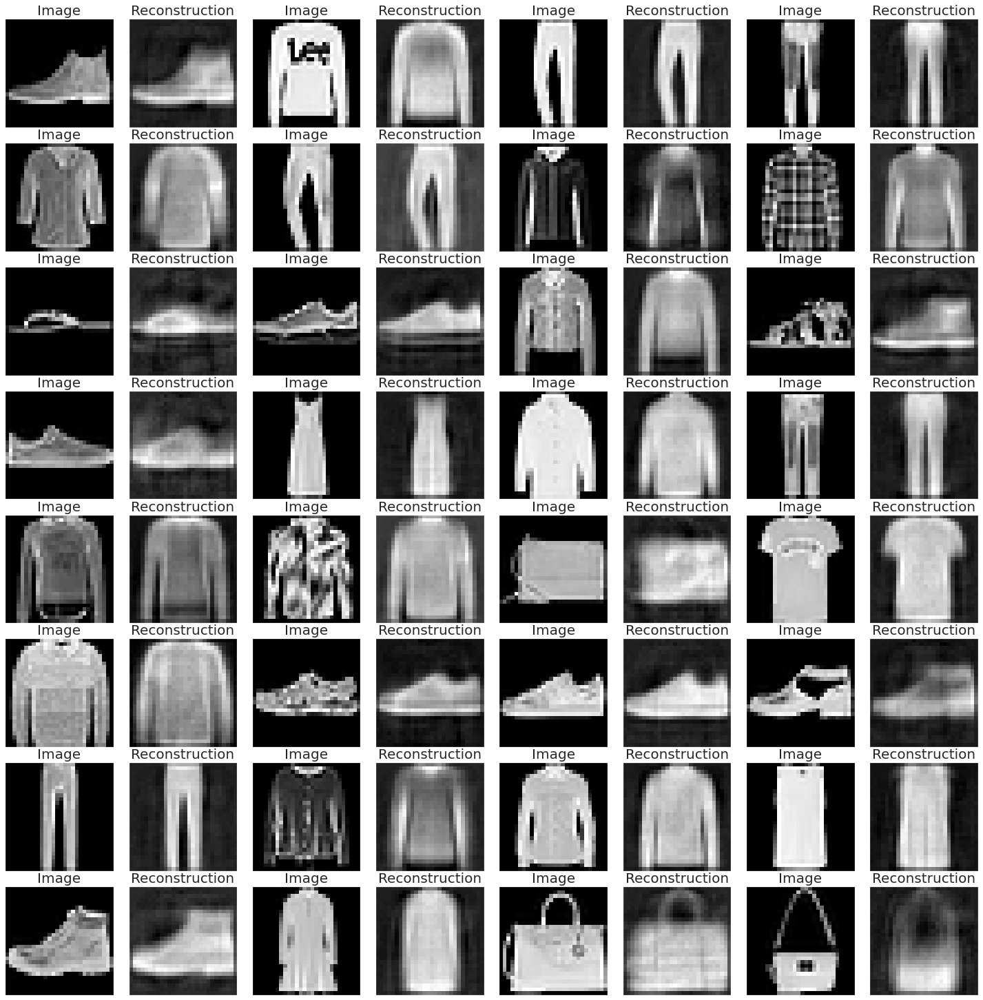

In [12]:
dl = model.test_dataloader()
for batch, lab in dl:
    logits = model(batch)
    logits = torch.reshape(logits, (64, 28, 28))
    utils.plot_autoencoder_results(batch, logits, ncols=8)
    break

As you can see above, the autoencoder is doing a resonable job of reconstructing the images.  It is definitely not perfect, and if you inspect the reconstructed images closely you will see a lack of fine spatial detail compared to the original images.  The autoencoder has managed to capture the salient details such that a human can recognize the class of the reconstructed image.

Now we will run our training data through the autoencoder, and we will use umap to plot the results and visualize the classes.  Redefine a dataloader so we can load the data all in one batch.

In [13]:
transform=transforms.Compose([transforms.ToTensor()])
fmnist_train = FashionMNIST(DATA_DIR, train=True, download=True, transform=transform)
dl = DataLoader(model.fmnist_train, batch_size=60000, num_workers=utils.get_num_cpus())

In [14]:
for batch, lab in dl:
    vecs = model.embedding_vector(batch).detach().numpy()
    labels = lab.detach().numpy()
    mnist_data = batch.numpy().squeeze()

In [15]:
import umap
standard_embedding = umap.UMAP(verbose=True).fit_transform(vecs)

UMAP(verbose=True)
Construct fuzzy simplicial set
Sat Aug 29 16:10:14 2020 Finding Nearest Neighbors
Sat Aug 29 16:10:14 2020 Building RP forest with 17 trees
Sat Aug 29 16:10:15 2020 NN descent for 16 iterations
	 0  /  16
	 1  /  16
	 2  /  16
	 3  /  16
	 4  /  16
	 5  /  16
Sat Aug 29 16:10:28 2020 Finished Nearest Neighbor Search


/home/cpadwick/code/pylightning/pl/lib/python3.6/site-packages/numba/np/ufunc/parallel.py:363: NumbaWarning: The TBB threading layer requires TBB version 2019.5 or later i.e., TBB_INTERFACE_VERSION >= 11005. Found TBB_INTERFACE_VERSION = 9107. The TBB threading layer is disabled.
  warnings.warn(problem)


Sat Aug 29 16:10:30 2020 Construct embedding
	completed  0  /  200 epochs
	completed  20  /  200 epochs
	completed  40  /  200 epochs
	completed  60  /  200 epochs
	completed  80  /  200 epochs
	completed  100  /  200 epochs
	completed  120  /  200 epochs
	completed  140  /  200 epochs
	completed  160  /  200 epochs
	completed  180  /  200 epochs
Sat Aug 29 16:10:53 2020 Finished embedding


In [16]:
idx = np.random.choice(standard_embedding.shape[0], 10000, replace=False)
reduced_embedding = standard_embedding[idx, :]
reduced_data = mnist_data[idx, :]
reduced_labels = labels[idx]

In [17]:
utils.plot_interactive_embedding(reduced_embedding,
                                 reduced_data,
                                 reduced_labels,
                                 classes,
                                 title='Fashion MNIST Autoencoder UMAP Embedding')  

Loading BokehJS ...